# Project Part 1: Understanding the Yelp data \& Data Pre-processing

### Preparation

In [1]:
# Imports
import json
import typing
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

import seaborn as sns
import gc
from mpl_toolkits.basemap import Basemap
from wordcloud import WordCloud
import squarify
import nltk
from nltk.corpus import stopwords 
from nltk.stem.porter import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer
import string
import re 
import gensim 
from gensim import corpora

%matplotlib inline
plt.style.use('fivethirtyeight')
plt.style.use('bmh')

In [2]:
def json_to_df(path):
    with open(path, encoding="utf8") as data_file:
        data = []
        for line in data_file:
            data.append(json.loads(line))
    df = pd.DataFrame(data)
    return df

### 1. Analysis of *yelp_academic_dataset_business.json*

In [11]:
df_business = json_to_df("C:/Users/Francis Zhou/Desktop/Data Science & Machine Learning/Semester 1/DSA5104 Principles of Data Management and Retrieval/Project/yelp_academic_dataset_business.json")
df_business.head(6)
# print(df_business.shape)

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,{'ByAppointmentOnly': 'True'},"Doctors, Traditional Chinese Medicine, Naturop...",None
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2..."
5,CF33F8-E6oudUQ46HnavjQ,Sonic Drive-In,615 S Main St,Ashland City,TN,37015,36.269593,-87.058943,2.0,6,1,"{'BusinessParking': 'None', 'BusinessAcceptsCr...","Burgers, Fast Food, Sandwiches, Food, Ice Crea...","{'Monday': '0:0-0:0', 'Tuesday': '6:0-22:0', '..."


In [12]:
df_business.shape

(150346, 14)

#### 1.1. Deal with the missing data

In [13]:
# Count of missing data for each attribute
print("Missing values count: ")
print(df_business.isnull().sum())
print("")

Missing values count: 
business_id         0
name                0
address             0
city                0
state               0
postal_code         0
latitude            0
longitude           0
stars               0
review_count        0
is_open             0
attributes      13744
categories        103
hours           23223
dtype: int64



In [14]:
# df_business[df_business.isnull().any(axis=1)]
# print(df_business.shape)
business = df_business.dropna()
business

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2..."
5,CF33F8-E6oudUQ46HnavjQ,Sonic Drive-In,615 S Main St,Ashland City,TN,37015,36.269593,-87.058943,2.0,6,1,"{'BusinessParking': 'None', 'BusinessAcceptsCr...","Burgers, Fast Food, Sandwiches, Food, Ice Crea...","{'Monday': '0:0-0:0', 'Tuesday': '6:0-22:0', '..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150340,hn9Toz3s-Ei3uZPt7esExA,West Side Kebab House,2470 Guardian Road NW,Edmonton,AB,T5T 1K8,53.509649,-113.675999,4.5,18,0,"{'Ambience': '{'touristy': False, 'hipster': F...","Middle Eastern, Restaurants","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'..."
150341,IUQopTMmYQG-qRtBk-8QnA,Binh's Nails,3388 Gateway Blvd,Edmonton,AB,T6J 5H2,53.468419,-113.492054,3.0,13,1,"{'ByAppointmentOnly': 'False', 'RestaurantsPri...","Nail Salons, Beauty & Spas","{'Monday': '10:0-19:30', 'Tuesday': '10:0-19:3..."
150342,c8GjPIOTGVmIemT7j5_SyQ,Wild Birds Unlimited,2813 Bransford Ave,Nashville,TN,37204,36.115118,-86.766925,4.0,5,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Pets, Nurseries & Gardening, Pet Stores, Hobby...","{'Monday': '9:30-17:30', 'Tuesday': '9:30-17:3..."
150344,mtGm22y5c2UHNXDFAjaPNw,Cyclery & Fitness Center,2472 Troy Rd,Edwardsville,IL,62025,38.782351,-89.950558,4.0,24,1,"{'BusinessParking': '{'garage': False, 'street...","Fitness/Exercise Equipment, Eyewear & Optician...","{'Monday': '9:0-20:0', 'Tuesday': '9:0-20:0', ..."


#### 1.2. Adjust data in each column

In [15]:
business.dtypes

business_id      object
name             object
address          object
city             object
state            object
postal_code      object
latitude        float64
longitude       float64
stars           float64
review_count      int64
is_open           int64
attributes       object
categories       object
hours            object
dtype: object

##### Require *business_id* as **22 character unique string**, *state* as **2 character string**, *stars* as **rounded to half-stars**. 

Adjust *business_id*

In [16]:
business['business_id'] = business['business_id'].astype(str)

# Uniqueness check
print(np.unique(business['business_id']).size == len(business['business_id']))
# Or
print(business.business_id.is_unique)

# Any row in business_id not of string length 22?
print((business['business_id'].str.len() != 22).any())

True
True
False


C:\Users\Francis Zhou\AppData\Local\Temp\ipykernel_22172\1395647064.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  business['business_id'] = business['business_id'].astype(str)


Adjust *state*

In [17]:
business['state'] = business['state'].astype(str)

# Any row in business_id not of string length 2?
print((business['state'].str.len() != 2).any())

False


C:\Users\Francis Zhou\AppData\Local\Temp\ipykernel_22172\1327602327.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  business['state'] = business['state'].astype(str)


Adjust *postal_code*

In [18]:
business = business[business['postal_code'].apply(lambda x: str(x).isdigit())]
business.head(6)

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2..."
5,CF33F8-E6oudUQ46HnavjQ,Sonic Drive-In,615 S Main St,Ashland City,TN,37015,36.269593,-87.058943,2.0,6,1,"{'BusinessParking': 'None', 'BusinessAcceptsCr...","Burgers, Fast Food, Sandwiches, Food, Ice Crea...","{'Monday': '0:0-0:0', 'Tuesday': '6:0-22:0', '..."
6,n_0UpQx1hsNbnPUSlodU8w,Famous Footwear,"8522 Eager Road, Dierbergs Brentwood Point",Brentwood,MO,63144,38.627695,-90.340465,2.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Sporting Goods, Fashion, Shoe Stores, Shopping...","{'Monday': '0:0-0:0', 'Tuesday': '10:0-18:0', ..."


Adjust *stars*

In [19]:
business['stars'].value_counts().sort_index()

stars
1.0      819
1.5     3124
2.0     6440
2.5    10084
3.0    13536
3.5    20214
4.0    24591
4.5    21999
5.0    12684
Name: count, dtype: int64

In [20]:
business['stars']

1         3.0
2         3.5
3         4.0
4         4.5
5         2.0
         ... 
150338    4.0
150339    4.5
150342    4.0
150344    4.0
150345    4.5
Name: stars, Length: 113491, dtype: float64

### EDA of *business*

After data cleaning, we shall proceed with some EDA with the new dataset *business*. 

#### Total number of businesses for each business name (utilize the attribute *name*)

Is the business name unique for each row of cnt?: True
There are in total 86009 unique businesses counted


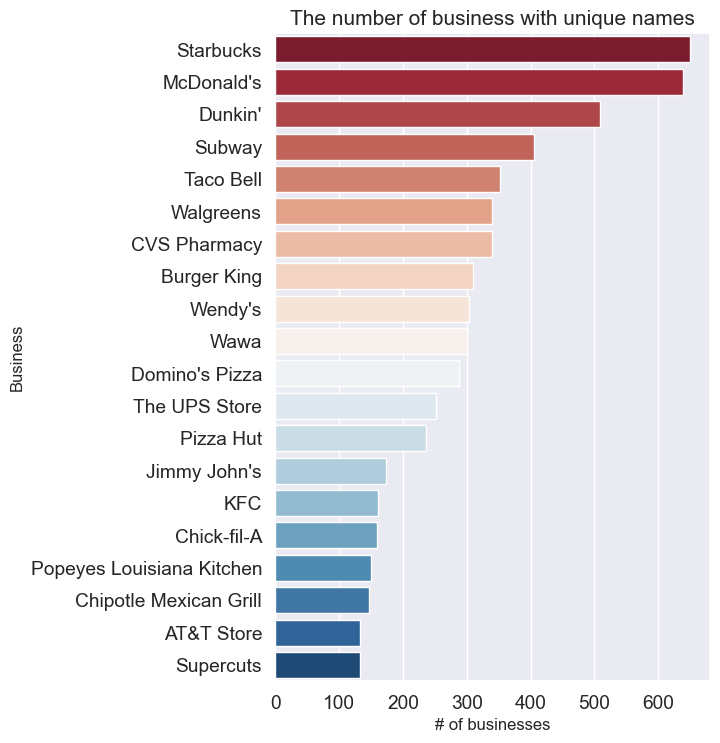

In [21]:
sns.set(font_scale=1.25)
ax1 = plt.figure(figsize=(5,8))
cnnt = business['name'].value_counts().to_frame()
cnt = pd.DataFrame(cnnt).reset_index()
cnt.columns = ['name', 'index']

print('Is the business name unique for each row of cnt?:', cnt.name.is_unique)
print('There are in total', cnt['name'].nunique(), 'unique businesses counted')
sns.barplot(x=cnt['index'].iloc[:20], y=cnt['name'].iloc[:20], data=cnt, palette = 'RdBu').set(title='The number of business with unique names')
plt.ylabel('Business', fontsize=12)
plt.xlabel('# of businesses', fontsize=12);

Observations:  
1. The number of names of unique businesses present in Yelp dataset is 86009;  
2. *Starbucks* is top in list of total businesses counted;  
3. Restaurant-related business is most popular business name (we shall check later with attribute *categories*).

#### Number of businesses in each city and each state (utilize attributes *city* \& *state*)

Number of city listed is 1261
Number of state listed is 23


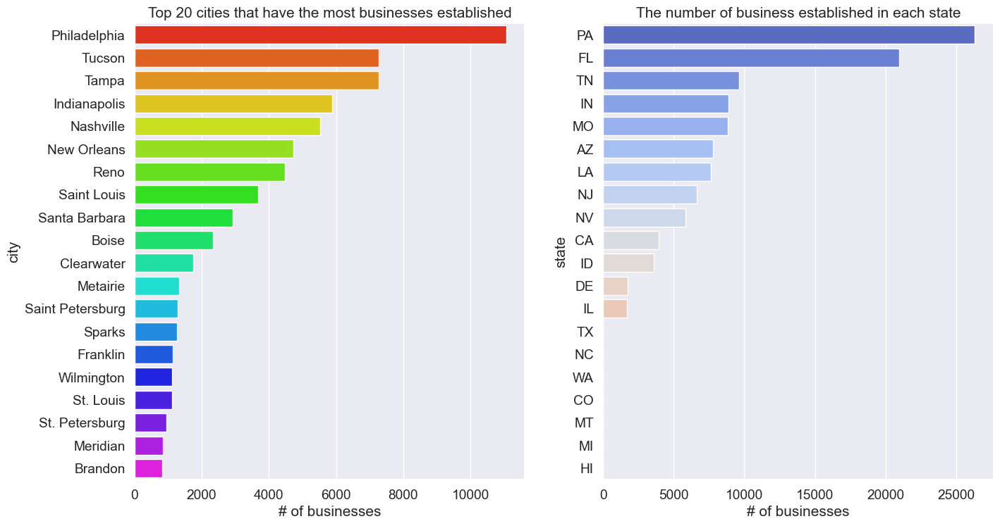

In [100]:
# City
print('Number of city listed is', business['city'].nunique())

sns.set(font_scale=1.25)
f,ax = plt.subplots(1,2, figsize=(14,8))
ax1,ax2, = ax.flatten()
cnnt = business['city'].value_counts().to_frame()
cnt = pd.DataFrame(cnnt).reset_index()
cnt.columns = ['city', 'index']

sns.barplot(x=cnt['index'].iloc[:20], y=cnt['city'].iloc[:20], data=cnt, palette = 'gist_rainbow', ax =ax1)
ax1.set_xlabel('# of businesses')
ax1.set_title('Top 20 cities that have the most businesses established')

# State
print('Number of state listed is', business['state'].nunique())
cnnt = business['state'].value_counts().to_frame()
cnt = pd.DataFrame(cnnt).reset_index()
cnt.columns = ['state', 'index']

sns.barplot(x=cnt['index'].iloc[:20], y=cnt['state'].iloc[:20], data=cnt, palette = 'coolwarm', ax =ax2)
ax2.set_xlabel('# of businesses')
ax2.set_title('The number of business established in each state');

Observations:  
1. We see that there are 1261 city listed in Yelp dataset;  
2. Philadelphia is top list in business listing in Yelp dataset followed by Tucson, Tampa etc.;  
3. There are 23 state listed in Yelp dataset;  
4. The state PA is top in the state list of Yelp dataset;  
5. There are almost half of states having very few business listing.

#### Location distribution (utilize attributes *latitude* \& *longtitude*)

In [27]:
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

m = folium.Map(location=[40.479627, -99.396414], tiles='cartodbpositron', zoom_start=4)

mc = MarkerCluster()
for idx, row in business.sample(100000).iterrows():
    mc.add_child(Marker([row['latitude'], row['longitude']]))
m.add_child(mc)
print("Map with 10k samples:")
m

Map with 10k samples:


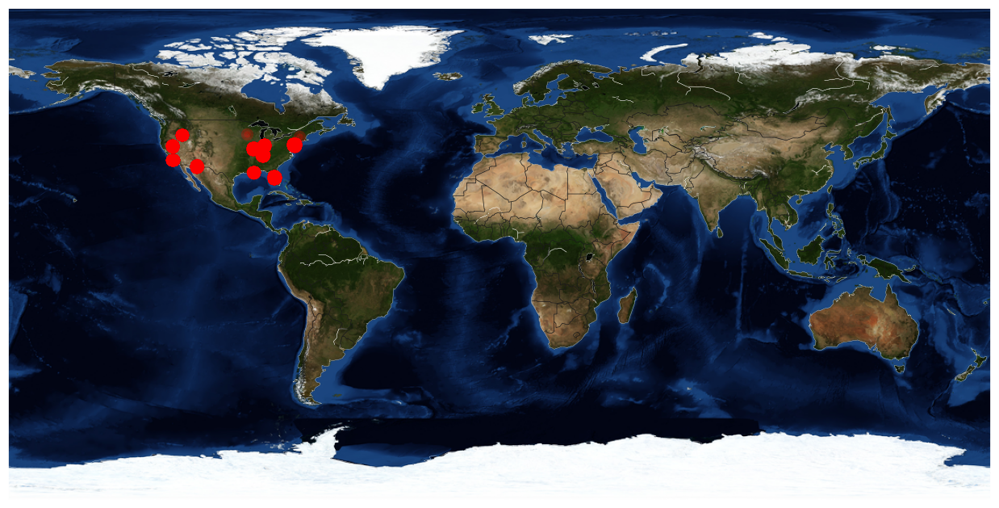

In [102]:
fig = plt.figure(figsize=(14, 10), edgecolor='w')
m = Basemap(projection='cyl',llcrnrlon= -180, urcrnrlon = 180, llcrnrlat = -90, urcrnrlat= 90, resolution='c', lat_ts = True)
m.bluemarble(scale=0.2)   # full scale will be overkill
m.drawcoastlines(color='white', linewidth=0.2)  # add coastlines
m.drawcountries() # add country border lines

mloc = m(business['latitude'].tolist(),business['longitude'].tolist())
m.scatter(mloc[1],mloc[0],color ='red',lw=5,alpha=0.25,zorder=2.5);

We may select one of the above map representation. 

#### Star ratings distribution (utilize the attribute *stars*)

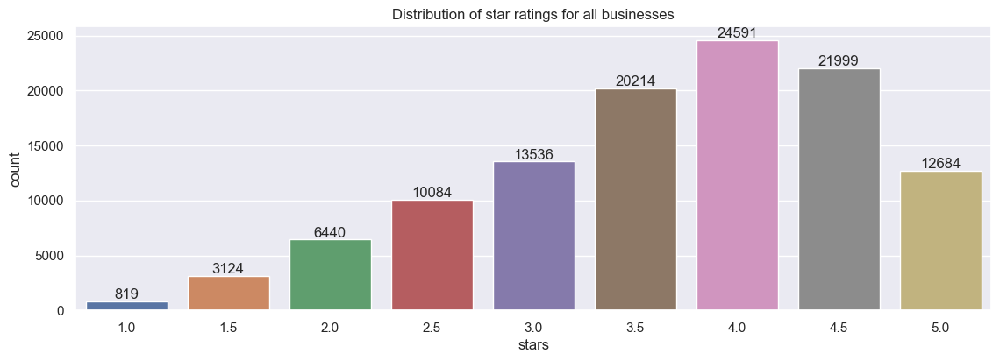

In [103]:
plt.figure(figsize=(12,4))
sns.set(font_scale=1)
ax = sns.countplot(business, x=business['stars'])
ax.bar_label(ax.containers[0], label_type='edge')
plt.title('Distribution of star ratings for all businesses');

We see that most customers give 3.5, 4, and 4.5 stars to businesses. 

#### Businesses that have most reviews counted (utilize attributes *name* and *review_count*)

Mean review count for all businesses is 71.37921612854468
Median review count for all businesses is 19.0


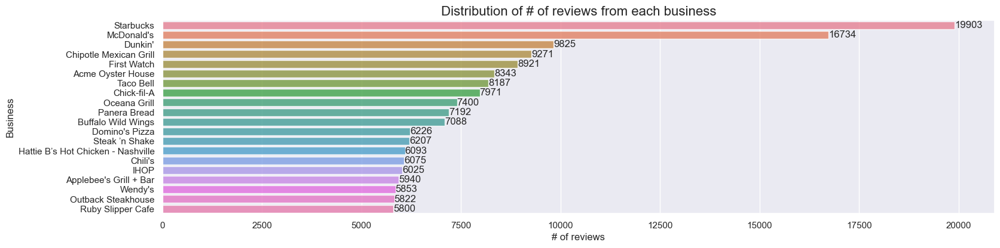

In [104]:
cnnt=business[['name', 'review_count']].sort_values(ascending=False, by="review_count")
cnnt=cnnt.groupby('name').sum()
cnt=pd.DataFrame(cnnt).reset_index()
cnt.columns = ['name', 'review_count']
cnt=cnt.sort_values(ascending=False, by="review_count")

print('Mean review count for all businesses is', cnt['review_count'].mean())
print('Median review count for all businesses is', cnt['review_count'].median())

#chart
plt.figure(figsize=(16,4))
sns.set(font_scale=1)
ax = sns.barplot(x=cnt['review_count'].iloc[0:20], y=cnt['name'].iloc[0:20], data=cnt, alpha=0.8, palette = 'husl')
ax.bar_label(ax.containers[0], label_type='edge')
plt.title("Distribution of # of reviews from each business", fontsize=16)
locs, labels = plt.xticks()
plt.setp(labels, rotation=0)
plt.ylabel('Business', fontsize=12)
plt.xlabel('# of reviews', fontsize=12)
plt.show()

#### Cities that have most reviews counted (utilize attributes *city* and *review_count*)

Mean review count for all cities is 4868.560666137986
Median review count for all cities is 88.0


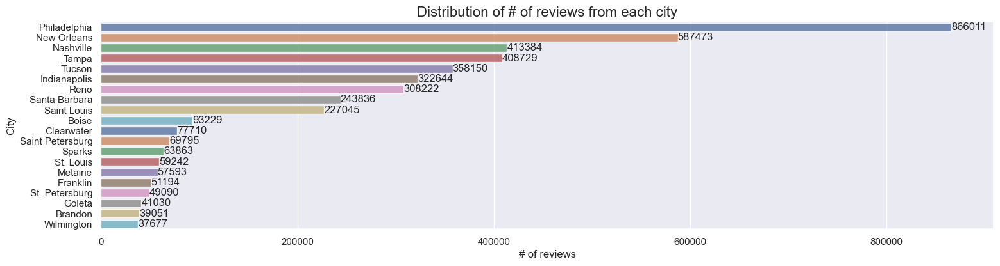

In [105]:
cnnt=business[['city', 'review_count']].sort_values(ascending=False, by="review_count")
cnnt=cnnt.groupby('city').sum()
cnt=pd.DataFrame(cnnt).reset_index()
cnt.columns = ['city', 'review_count']
cnt=cnt.sort_values(ascending=False, by="review_count")

print('Mean review count for all cities is', cnt['review_count'].mean())
print('Median review count for all cities is', cnt['review_count'].median())

#chart
plt.figure(figsize=(16,4))
sns.set(font_scale=1)
ax = sns.barplot(x=cnt['review_count'].iloc[0:20], y=cnt['city'].iloc[0:20], data=cnt, alpha=0.8, palette = 'deep')
ax.bar_label(ax.containers[0], label_type='edge')
plt.title("Distribution of # of reviews from each city", fontsize=16)
locs, labels = plt.xticks()
plt.setp(labels, rotation=0)
plt.ylabel('City', fontsize=12)
plt.xlabel('# of reviews', fontsize=12)
plt.show()

#### Number of *is_open* distribution

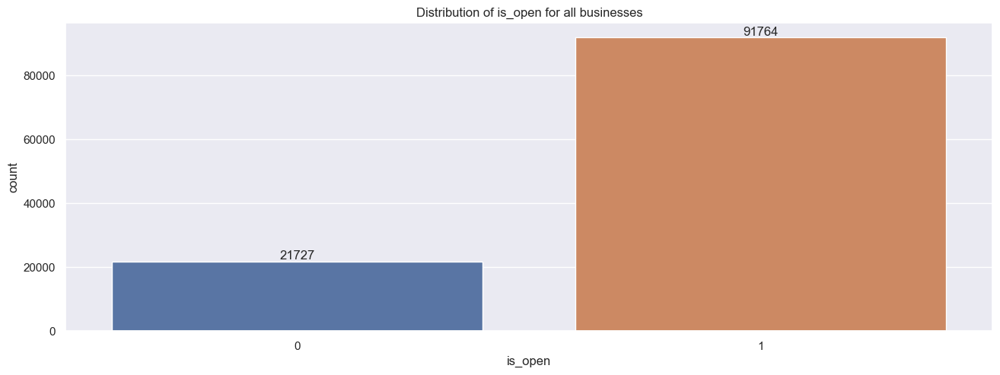

In [106]:
plt.figure(figsize=(14,5))
sns.set(font_scale=1)
ax = sns.countplot(business, x=business['is_open'])
ax.bar_label(ax.containers[0], label_type='edge')
plt.title('Distribution of is_open for all businesses');

Observation: Most of business are still operating.

#### Analysis of *category* attribute

C:\Users\Francis Zhou\AppData\Local\Temp\ipykernel_85100\1015200423.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  business['categories'] += ','


Number of total unique categories listed is 2383


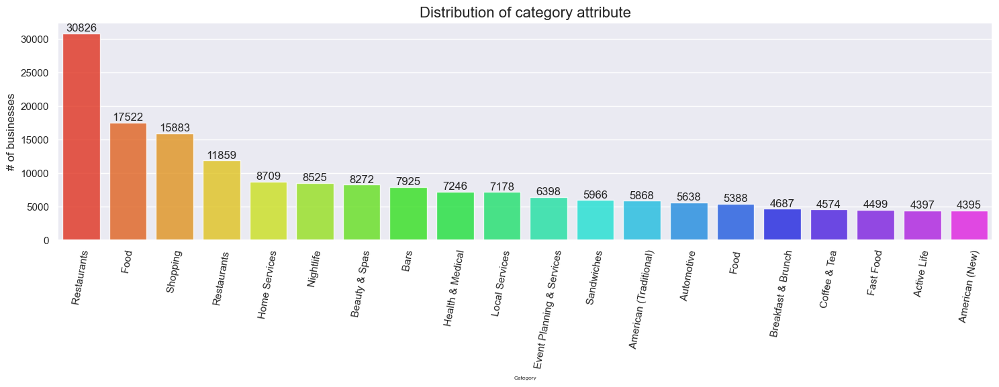

In [107]:
business['categories'] += ','
business_cats = ''.join(business['categories'].astype('str'))
cats=pd.DataFrame(business_cats.split(','),columns=['categories'])
cats=cats[:-1]

#prep for chart
cnnt=cats.categories.value_counts()

cnnt=cnnt.sort_values(ascending=False)
cnt=cnnt.to_frame()
cnt=pd.DataFrame(cnt).reset_index()
cnt.columns = ['category', 'index']

print('Number of total unique categories listed is', cnt['category'].nunique())

#chart
plt.figure(figsize=(16,4))
sns.set(font_scale=1)
ax = sns.barplot(x=cnt['category'].iloc[0:20], y=cnt['index'].iloc[0:20], data=cnt, alpha=0.8, palette = 'gist_rainbow')
ax.bar_label(ax.containers[0], label_type='edge')
plt.title("Distribution of category attribute",fontsize=16)
locs, labels = plt.xticks()
plt.setp(labels, rotation=80)
plt.ylabel('# of businesses', fontsize=12)
plt.xlabel('Category', fontsize=6)
plt.show()

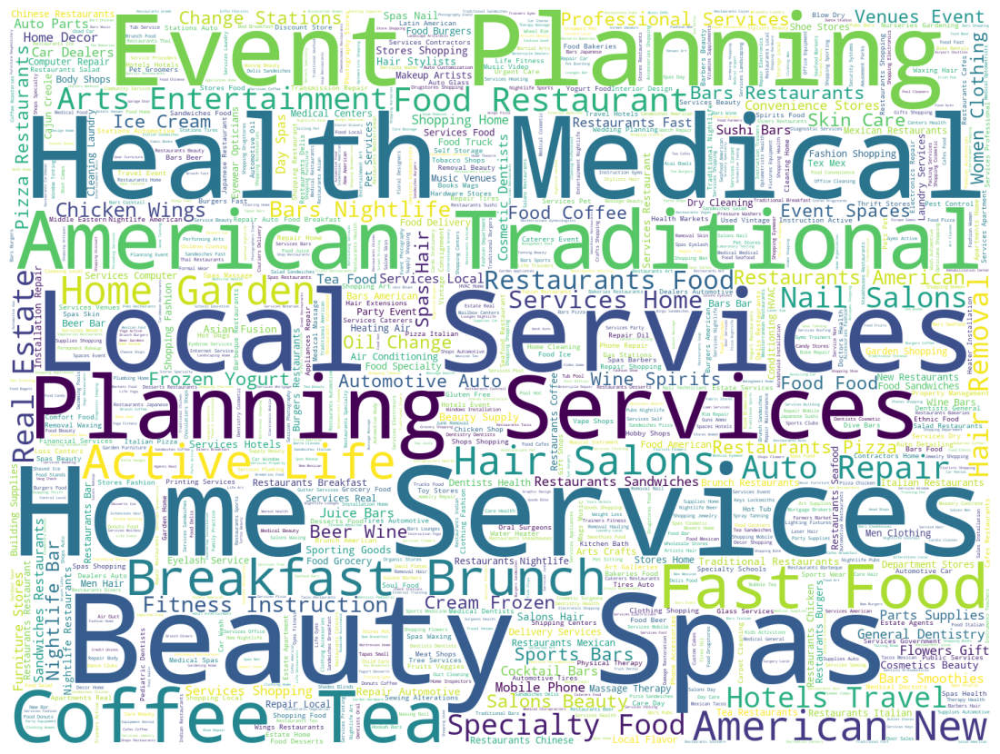

In [108]:
cloud = WordCloud(width=1440, height= 1080,max_words= 1000, background_color='white').generate(business_cats)
plt.figure(figsize=(14, 10))
plt.imshow(cloud)
plt.axis('off');

Export the cleaned *business* dataset to business.csv

In [ ]:
business.to_csv('business.csv', index=False)

In [ ]:
business.info()

### 2. Analysis of *yelp_academic_dataset_checkin.json*

In [109]:
df_checkin = json_to_df("C:/Users/Francis Zhou/Desktop/Data Science & Machine Learning/Semester 1/DSA5104 Principles of Data Management and Retrieval/Project/yelp_academic_dataset_checkin.json")
df_checkin.head(6)

,business_id,date
0,---kPU91CF4Lq2-WlRu9Lw,"2020-03-13 21:10:56, 2020-06-02 22:18:06, 2020..."
1,--0iUa4sNDFiZFrAdIWhZQ,"2010-09-13 21:43:09, 2011-05-04 23:08:15, 2011..."
2,--30_8IhuyMHbSOcNWd6DQ,"2013-06-14 23:29:17, 2014-08-13 23:20:22"
3,--7PUidqRWpRSpXebiyxTg,"2011-02-15 17:12:00, 2011-07-28 02:46:10, 2012..."
4,--7jw19RH9JKXgFohspgQw,"2014-04-21 20:42:11, 2014-04-28 21:04:46, 2014..."
5,--8IbOsAAxjKRoYsBFL-PA,"2015-06-06 01:03:19, 2015-07-29 16:50:58, 2015..."


In [142]:
df_checkin.shape

(131930, 2)

#### Deal with the missing data

In [111]:
# Count of missing data for each attribute
print("Missing values count: ")
print(df_checkin.isnull().sum())
print("")

Missing values count: 
business_id    0
date           0
dtype: int64



No missing value exists. 

In [112]:
checkin = df_checkin.dropna()
checkin['business_id'] = checkin['business_id'].astype(str)

# Uniqueness check
print(np.unique(checkin['business_id']).size == len(checkin['business_id']))
# Or
print(checkin.business_id.is_unique)

# Any row in business_id not of string length 22?
print((checkin['business_id'].str.len() != 22).any())

True
True
False


In [113]:
checkin['date'] += ','
checkin_cats = ''.join(checkin['date'].astype('str'))
cats=pd.DataFrame(checkin_cats.split(','),columns=['date_time'])
cats=cats[:-1]


In [118]:
cats

,date_time
0,2020-03-13 21:10:56
1,2020-06-02 22:18:06
2,2020-07-24 22:42:27
3,2020-10-24 21:36:13
4,2020-12-09 21:23:33
...,...
13356870,2013-12-11 00:52:49
13356871,2013-12-13 00:58:14
13356872,2016-12-03 23:33:26
13356873,2018-12-02 19:08:45


In [ ]:
# for ind in cats.index: 
#     day=pd.to_datetime(cats["date_time"].iloc[ind]).strftime("%Y-%d-%m")
#     time=pd.to_datetime(cats["date_time"].iloc[ind]).strftime("%H:%M:%S")

# cats_day=pd.DataFrame(day,columns=['day'])
# cats_time=pd.DataFrame(time,columns=['time'])

# cats_day.head(6)
# cats_time.head(6)

In [129]:
checkin.tail(25)

,business_id,date
131905,zz18xL0peOpD-ENMEF6hcQ,"2013-04-25 23:26:44,"
131906,zz3E7kmJI2r2JseE6LAnrw,"2010-09-11 14:19:48, 2010-09-25 16:15:17, 2010..."
131907,zz6_dk1S63QQNBSaq3iXEg,"2016-01-27 16:15:09, 2016-01-28 15:17:29, 2016..."
131908,zzFCdBSW27eKFg-xG7cqAg,"2011-03-04 18:20:43, 2012-06-16 16:35:35, 2012..."
131909,zzHtFjfM7NvuVM1HTsCLGA,"2019-11-09 02:16:59, 2019-11-19 18:04:37, 2019..."
131910,zzIF9qp2UoHN48EeZH_IDg,"2013-07-15 01:36:36, 2016-02-19 23:31:08, 2017..."
131911,zzKVqizyl3QCb3GZmg_cNg,"2012-05-02 12:52:12, 2012-06-06 15:45:42, 2012..."
131912,zzO2zgfqP9ANmEWt-EZFWg,"2010-12-23 20:53:18, 2010-12-24 23:16:11, 2010..."
131913,zzQWjZ_1Dr7kkDYlk17qRw,"2018-08-12 04:20:39, 2018-09-24 08:05:08, 2018..."
131914,zzRZMOmhjgUbzZSSWJT5aw,"2011-08-14 15:49:56, 2011-10-22 18:54:06, 2012..."


In [130]:
cats.tail(20)

,date_time
13356855,2012-07-21 01:52:39
13356856,2012-07-21 01:53:58
13356857,2012-08-25 01:35:33
13356858,2012-10-28 00:35:18
13356859,2013-01-31 18:22:55
13356860,2013-03-02 01:11:50
13356861,2013-04-03 23:23:34
13356862,2013-04-13 23:59:00
13356863,2013-04-14 00:54:53
13356864,2013-04-16 23:36:48


In [131]:
cats[:-1]

,date_time
0,2020-03-13 21:10:56
1,2020-06-02 22:18:06
2,2020-07-24 22:42:27
3,2020-10-24 21:36:13
4,2020-12-09 21:23:33
...,...
13356869,2013-07-14 00:29:38
13356870,2013-12-11 00:52:49
13356871,2013-12-13 00:58:14
13356872,2016-12-03 23:33:26


Primary Key of *df_checkin* is **business_id**.

Export the cleaned *business* dataset to checkin.csv

In [132]:
checkin.to_csv('checkin.csv', index=False)

In [133]:
checkin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 131930 entries, 0 to 131929
Data columns (total 2 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   business_id  131930 non-null  object
 1   date         131930 non-null  object
dtypes: object(2)
memory usage: 2.0+ MB


### 3. Analysis of *yelp_academic_dataset_review.json*

In [134]:
df_review = json_to_df("C:/Users/Francis Zhou/Desktop/Data Science & Machine Learning/Semester 1/DSA5104 Principles of Data Management and Retrieval/Project/yelp_academic_dataset_review.json")
df_review.head(6)

,review_id,user_id,business_id,stars,useful,funny,cool,text,date
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3.0,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5.0,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3.0,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5.0,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4.0,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15
5,JrIxlS1TzJ-iCu79ul40cQ,eUta8W_HdHMXPzLBBZhL1A,04UD14gamNjLY0IDYVhHJg,1.0,1,2,1,I am a long term frequent customer of this est...,2015-09-23 23:10:31


In [144]:
df_review.shape

(6990280, 9)

#### 3.1. Deal with the missing data

In [135]:
# Count of missing data for each attribute
print("Missing values count: ")
print(df_review.isnull().sum())
print("")

Missing values count: 
review_id      0
user_id        0
business_id    0
stars          0
useful         0
funny          0
cool           0
text           0
date           0
dtype: int64



No missing value exists. 

In [136]:
review = df_review.dropna()
review

,review_id,user_id,business_id,stars,useful,funny,cool,text,date
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3.0,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5.0,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3.0,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5.0,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4.0,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15
...,...,...,...,...,...,...,...,...,...
6990275,H0RIamZu0B0Ei0P4aeh3sQ,qskILQ3k0I_qcCMI-k6_QQ,jals67o91gcrD4DC81Vk6w,5.0,1,2,1,Latest addition to services from ICCU is Apple...,2014-12-17 21:45:20
6990276,shTPgbgdwTHSuU67mGCmZQ,Zo0th2m8Ez4gLSbHftiQvg,2vLksaMmSEcGbjI5gywpZA,5.0,2,1,2,"This spot offers a great, affordable east week...",2021-03-31 16:55:10
6990277,YNfNhgZlaaCO5Q_YJR4rEw,mm6E4FbCMwJmb7kPDZ5v2Q,R1khUUxidqfaJmcpmGd4aw,4.0,1,0,0,This Home Depot won me over when I needed to g...,2019-12-30 03:56:30
6990278,i-I4ZOhoX70Nw5H0FwrQUA,YwAMC-jvZ1fvEUum6QkEkw,Rr9kKArrMhSLVE9a53q-aA,5.0,1,0,0,For when I'm feeling like ignoring my calorie-...,2022-01-19 18:59:27


#### 3.2. Adjust data in each column

In [145]:
review.dtypes

review_id       object
user_id         object
business_id     object
stars          float64
useful           int64
funny            int64
cool             int64
text            object
date            object
dtype: object

##### Require *review_id* as **22 character unique string**, *user_id* as **22 character unique string**, *business_id* as **22 character unique string**, *stars* as **integer**. 

In [146]:
# review.id
review['review_id'] = review['review_id'].astype(str)

# Uniqueness check
print(np.unique(review['review_id']).size == len(review['review_id']))
# Or
print(review.review_id.is_unique)

# Any row in review_id not of string length 22?
print((review['review_id'].str.len() != 22).any())

True
True
False


In [14]:
# user.id
review['user_id'] = review['user_id'].astype(str)

# Uniqueness check
print(np.unique(review['user_id']).size == len(review['user_id']))
# Or
print(review.user_id.is_unique)

# Any row in user_id not of string length 22?
print((review['user_id'].str.len() != 22).any())

print(np.unique(review['user_id']).size)
print(len(review['user_id']))

False
False
False
1987929
6990280


In [15]:
# business.id
review['business_id'] = review['business_id'].astype(str)

# Uniqueness check
print(np.unique(review['business_id']).size == len(review['business_id']))
# Or
print(review.business_id.is_unique)

# Any row in user_id not of string length 22?
print((review['business_id'].str.len() != 22).any())

print(np.unique(review['business_id']).size)
print(len(review['business_id']))

False
False
False
150346
6990280


In [16]:
# stars
review['stars'] = review['stars'].astype(int)
review['stars'].head(6)

0    3
1    5
2    3
3    5
4    4
5    1
Name: stars, dtype: int32

In [18]:
review.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6990280 entries, 0 to 6990279
Data columns (total 9 columns):
 #   Column       Dtype 
---  ------       ----- 
 0   review_id    object
 1   user_id      object
 2   business_id  object
 3   stars        int32 
 4   useful       int64 
 5   funny        int64 
 6   cool         int64 
 7   text         object
 8   date         object
dtypes: int32(1), int64(3), object(5)
memory usage: 453.3+ MB


Primary key of *df_review* is **review_id**.

#### EDA on Review

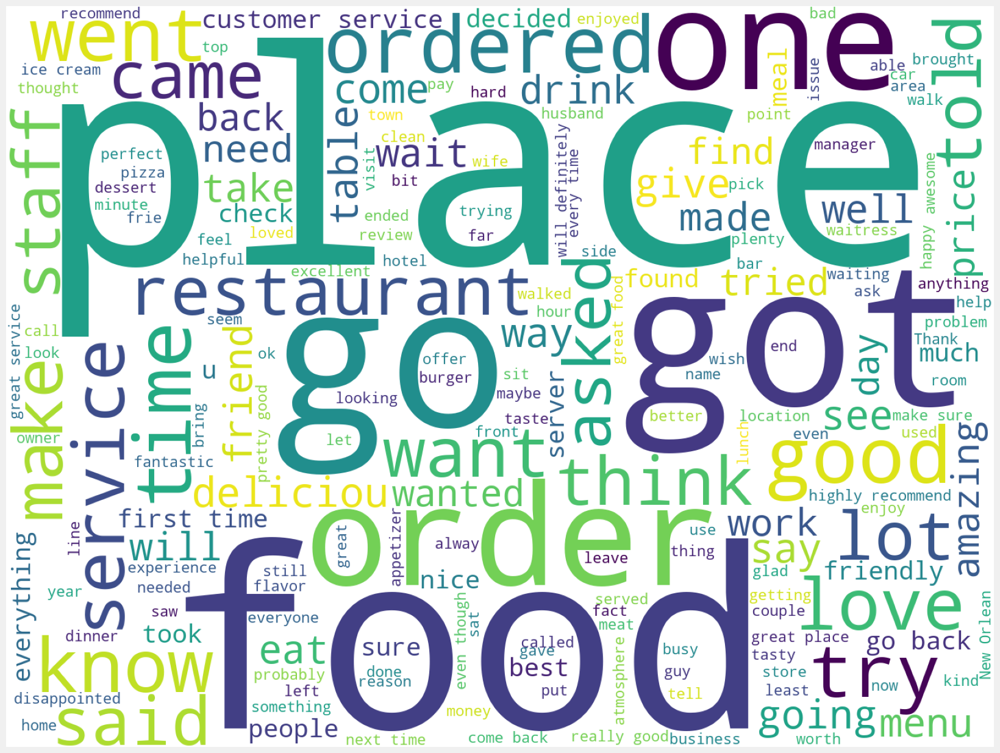

In [19]:
# Word cloud
cloud = WordCloud(width=1440, height= 1080, max_words= 200, background_color='white').generate(' '.join(review['text'].astype(str)))
plt.figure(figsize=(20, 15))
plt.imshow(cloud)
plt.axis('off');

Export the cleaned *review* dataset to review.csv

In [ ]:
review.to_csv('review.csv', index=False)

### 4. Analysis of *yelp_academic_dataset_tip.json*

In [3]:
df_tip = json_to_df("C:/Users/Francis Zhou/Desktop/Data Science & Machine Learning/Semester 1/DSA5104 Principles of Data Management and Retrieval/Project/yelp_academic_dataset_tip.json")
df_tip.head(6)

,user_id,business_id,text,date,compliment_count
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0
1,NBN4MgHP9D3cw--SnauTkA,QoezRbYQncpRqyrLH6Iqjg,They have lots of good deserts and tasty cuban...,2013-02-05 18:35:10,0
2,-copOvldyKh1qr-vzkDEvw,MYoRNLb5chwjQe3c_k37Gg,It's open even when you think it isn't,2013-08-18 00:56:08,0
3,FjMQVZjSqY8syIO-53KFKw,hV-bABTK-glh5wj31ps_Jw,Very decent fried chicken,2017-06-27 23:05:38,0
4,ld0AperBXk1h6UbqmM80zw,_uN0OudeJ3Zl_tf6nxg5ww,Appetizers.. platter special for lunch,2012-10-06 19:43:09,0
5,trf3Qcz8qvCDKXiTgjUcEg,7Rm9Ba50bw23KTA8RedZYg,"Chili Cup + Single Cheeseburger with onion, pi...",2012-03-13 04:00:52,0


In [4]:
df_tip.shape

(908915, 5)

#### 4.1. Deal with the missing data

In [5]:
# Count of missing data for each attribute
print("Missing values count: ")
print(df_tip.isnull().sum())
print("")

Missing values count: 
user_id             0
business_id         0
text                0
date                0
compliment_count    0
dtype: int64



No missing data exists. 

In [6]:
tip = df_tip.dropna()
tip

,user_id,business_id,text,date,compliment_count
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0
1,NBN4MgHP9D3cw--SnauTkA,QoezRbYQncpRqyrLH6Iqjg,They have lots of good deserts and tasty cuban...,2013-02-05 18:35:10,0
2,-copOvldyKh1qr-vzkDEvw,MYoRNLb5chwjQe3c_k37Gg,It's open even when you think it isn't,2013-08-18 00:56:08,0
3,FjMQVZjSqY8syIO-53KFKw,hV-bABTK-glh5wj31ps_Jw,Very decent fried chicken,2017-06-27 23:05:38,0
4,ld0AperBXk1h6UbqmM80zw,_uN0OudeJ3Zl_tf6nxg5ww,Appetizers.. platter special for lunch,2012-10-06 19:43:09,0
...,...,...,...,...,...
908910,eYodOTF8pkqKPzHkcxZs-Q,3lHTewuKFt5IImbXJoFeDQ,Disappointed in one of your managers.,2021-09-11 19:18:57,0
908911,1uxtQAuJ2T5Xwa_wp7kUnA,OaGf0Dp56ARhQwIDT90w_g,Great food and service.,2021-10-30 11:54:36,0
908912,v48Spe6WEpqehsF2xQADpg,hYnMeAO77RGyTtIzUSKYzQ,Love their Cubans!!,2021-11-05 13:18:56,0
908913,ckqKGM2hl7I9Chp5IpAhkw,s2eyoTuJrcP7I_XyjdhUHQ,Great pizza great price,2021-11-20 16:11:44,0


In [7]:
print(tip.duplicated().sum())

67


### There are 67 duplicates in *tip*. Need to remove them. Which exactly are they? 

In [8]:
tip.loc[tip.duplicated(), :]

,user_id,business_id,text,date,compliment_count
29901,00Cz_vdInMHpTRjqbWjK5Q,ncacMQ9n_dSM1cR3c1vTQw,Miss saigon,2010-12-07 01:59:12,0
58887,47zMh_WgunwRDf7Cx2WyYw,J8vz_zwZaxzA585lV_k_vA,Com chien and mi are delish!,2011-07-23 17:22:58,0
99407,WQ8shYm0ghNDz97BuHI1fA,Sv1MEZP-mMfp8SmE0hwYEA,love the crispy buns!,2017-10-18 23:29:03,0
126358,hGxVvXVg7IK4J2aTiGMSIQ,5RsVAkDnMrcSbErS6P1eew,"Pricey, often crowded, and staff are not alway...",2017-10-20 22:08:25,0
129213,1gDoko0TrN0lnQlMC2JtXw,06PmqoU3uY5Vb-BEaMPVfw,"We ordered a pizza on New Year's Day, it never...",2014-02-20 04:09:37,0
...,...,...,...,...,...
793788,nnWFrvhO2jeq0KbG_CKCYA,jmG_QxXXfz2cnw9dQCXJLQ,"Great place, great baked goods!",2019-06-08 17:06:50,0
794036,ajDPsSD77sxcVttPfftBRQ,DTxB12bQaZ1m-nLeXWX2rw,Good service and delicious food,2017-09-12 23:01:50,0
820290,wYo3aBVj-bRPT7E4RSj5Kg,W5SNps2JaT_RozLAl_TN1Q,Worker there are the best at serving me quick ...,2017-12-17 01:10:52,0
873070,TEjijSowDwJM4vCL-zn4ew,YPHDzg1h-PkaxfoppT-iJg,bleed blue,2011-09-26 00:03:49,0


### Then, drop the duplicates in the original dataset *tip*

In [9]:
tip.drop_duplicates(inplace=True)
print(tip.duplicated().sum())

0


In [10]:
tip.shape

(908848, 5)

#### 4.2. Adjust data in each column

In [174]:
tip.dtypes

user_id             object
business_id         object
text                object
date                object
compliment_count     int64
dtype: object

##### Require *business_id* as **22 character unique string**, *user_id* as **22 character unique string**. 

In [175]:
# business_id
tip['business_id'] = tip['business_id'].astype(str)

# Uniqueness check
print(np.unique(tip['business_id']).size == len(tip['business_id']))

# Any row in business_id not of string length 22?
print((tip['business_id'].str.len() != 22).any())

print(np.unique(tip['business_id']).size)
print(len(tip['business_id']))

False
False
106193
908848


In [176]:
# user_id
tip['user_id'] = tip['user_id'].astype(str)

# Uniqueness check
print(np.unique(tip['user_id']).size == len(tip['user_id']))

# Any row in business_id not of string length 22?
print((tip['user_id'].str.len() != 22).any())

print(np.unique(tip['user_id']).size)
print(len(tip['user_id']))

False
False
301758
908848


In [177]:
df_tip[df_tip["business_id"] == "3uLgwr0qeCNMjKenHJwPGQ"]

,user_id,business_id,text,date,compliment_count
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0
15521,-PNOT-APcKKu9PFokhCtJA,3uLgwr0qeCNMjKenHJwPGQ,The Dark Knight Rises in XD! I don't know what...,2012-07-22 02:22:54,0
41035,wzX8UssOglKwSDx8qob8zA,3uLgwr0qeCNMjKenHJwPGQ,Cleanliness matters....I just sat down to watc...,2018-04-28 17:33:05,0
65827,bQmEEqlobO4J0oasLUTX0Q,3uLgwr0qeCNMjKenHJwPGQ,Early bird gets the worm!,2011-10-30 19:10:34,0
79696,u2NnaNOcwOVCWDYeGQpoaA,3uLgwr0qeCNMjKenHJwPGQ,Brand new seats!,2015-03-22 18:12:37,0
83517,zdw1jwmw1TNLZgu_is_Seg,3uLgwr0qeCNMjKenHJwPGQ,Seeing the Amazing Spider Man. Loving this th...,2012-07-07 01:38:48,0
83705,ehgLycOK6qKj-CT9B36_oQ,3uLgwr0qeCNMjKenHJwPGQ,XD is awesome,2012-05-04 05:40:38,0
156322,wvNrdBUqj0K6FPccvO8SPA,3uLgwr0qeCNMjKenHJwPGQ,Captain America rocks!,2011-07-26 19:52:24,0
171757,juigu8XxwzLAeikeBzULbg,3uLgwr0qeCNMjKenHJwPGQ,Bully,2012-05-05 18:41:27,0
208063,pQG9KuaX5Rpd8Zdf_aiTXA,3uLgwr0qeCNMjKenHJwPGQ,MIBIII was dope!,2012-06-03 07:43:24,0


In [185]:
table_tip_AGNUgVwnZUey3gcPCJ76iw = df_tip[df_tip["user_id"] == "AGNUgVwnZUey3gcPCJ76iw"]
table_tip_AGNUgVwnZUey3gcPCJ76iw[table_tip_AGNUgVwnZUey3gcPCJ76iw["business_id"] == "3uLgwr0qeCNMjKenHJwPGQ"]

,user_id,business_id,text,date,compliment_count,userbusiness_id
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0,AGNUgVwnZUey3gcPCJ76iw3uLgwr0qeCNMjKenHJwPGQ


In [186]:
df_tip["userbusiness_id"] = df_tip["user_id"] + df_tip["business_id"]
df_tip

,user_id,business_id,text,date,compliment_count,userbusiness_id
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0,AGNUgVwnZUey3gcPCJ76iw3uLgwr0qeCNMjKenHJwPGQ
1,NBN4MgHP9D3cw--SnauTkA,QoezRbYQncpRqyrLH6Iqjg,They have lots of good deserts and tasty cuban...,2013-02-05 18:35:10,0,NBN4MgHP9D3cw--SnauTkAQoezRbYQncpRqyrLH6Iqjg
2,-copOvldyKh1qr-vzkDEvw,MYoRNLb5chwjQe3c_k37Gg,It's open even when you think it isn't,2013-08-18 00:56:08,0,-copOvldyKh1qr-vzkDEvwMYoRNLb5chwjQe3c_k37Gg
3,FjMQVZjSqY8syIO-53KFKw,hV-bABTK-glh5wj31ps_Jw,Very decent fried chicken,2017-06-27 23:05:38,0,FjMQVZjSqY8syIO-53KFKwhV-bABTK-glh5wj31ps_Jw
4,ld0AperBXk1h6UbqmM80zw,_uN0OudeJ3Zl_tf6nxg5ww,Appetizers.. platter special for lunch,2012-10-06 19:43:09,0,ld0AperBXk1h6UbqmM80zw_uN0OudeJ3Zl_tf6nxg5ww
...,...,...,...,...,...,...
908910,eYodOTF8pkqKPzHkcxZs-Q,3lHTewuKFt5IImbXJoFeDQ,Disappointed in one of your managers.,2021-09-11 19:18:57,0,eYodOTF8pkqKPzHkcxZs-Q3lHTewuKFt5IImbXJoFeDQ
908911,1uxtQAuJ2T5Xwa_wp7kUnA,OaGf0Dp56ARhQwIDT90w_g,Great food and service.,2021-10-30 11:54:36,0,1uxtQAuJ2T5Xwa_wp7kUnAOaGf0Dp56ARhQwIDT90w_g
908912,v48Spe6WEpqehsF2xQADpg,hYnMeAO77RGyTtIzUSKYzQ,Love their Cubans!!,2021-11-05 13:18:56,0,v48Spe6WEpqehsF2xQADpghYnMeAO77RGyTtIzUSKYzQ
908913,ckqKGM2hl7I9Chp5IpAhkw,s2eyoTuJrcP7I_XyjdhUHQ,Great pizza great price,2021-11-20 16:11:44,0,ckqKGM2hl7I9Chp5IpAhkws2eyoTuJrcP7I_XyjdhUHQ


In [187]:
np.unique(df_tip["userbusiness_id"]).size

784784

In [188]:
len(df_tip["userbusiness_id"])

908915

**After removing all duplicates, there is no Primary Key for *tip*.**

Export the cleaned *tip* dataset to tip.csv

In [ ]:
tip.to_csv('tip.csv', index=False)

### 5. Analysis of *yelp_academic_dataset_user.json*

In [189]:
df_user = json_to_df("C:/Users/Francis Zhou/Desktop/Data Science & Machine Learning/Semester 1/DSA5104 Principles of Data Management and Retrieval/Project/yelp_academic_dataset_user.json")
df_user.head(6)

,user_id,name,review_count,yelping_since,useful,funny,cool,elite,friends,fans,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,qVc8ODYU5SZjKXVBgXdI7w,Walker,585,2007-01-25 16:47:26,7217,1259,5994,2007,"NSCy54eWehBJyZdG2iE84w, pe42u7DcCH2QmI81NX-8qA...",267,...,65,55,56,18,232,844,467,467,239,180
1,j14WgRoU_-2ZE1aw1dXrJg,Daniel,4333,2009-01-25 04:35:42,43091,13066,27281,"2009,2010,2011,2012,2013,2014,2015,2016,2017,2...","ueRPE0CX75ePGMqOFVj6IQ, 52oH4DrRvzzl8wh5UXyU0A...",3138,...,264,184,157,251,1847,7054,3131,3131,1521,1946
2,2WnXYQFK0hXEoTxPtV2zvg,Steph,665,2008-07-25 10:41:00,2086,1010,1003,"2009,2010,2011,2012,2013","LuO3Bn4f3rlhyHIaNfTlnA, j9B4XdHUhDfTKVecyWQgyA...",52,...,13,10,17,3,66,96,119,119,35,18
3,SZDeASXq7o05mMNLshsdIA,Gwen,224,2005-11-29 04:38:33,512,330,299,"2009,2010,2011","enx1vVPnfdNUdPho6PH_wg, 4wOcvMLtU6a9Lslggq74Vg...",28,...,4,1,6,2,12,16,26,26,10,9
4,hA5lMy-EnncsH4JoR-hFGQ,Karen,79,2007-01-05 19:40:59,29,15,7,,"PBK4q9KEEBHhFvSXCUirIw, 3FWPpM7KU1gXeOM_ZbYMbA...",1,...,1,0,0,0,1,1,0,0,0,0
5,q_QQ5kBBwlCcbL1s4NVK3g,Jane,1221,2005-03-14 20:26:35,14953,9940,11211,"2006,2007,2008,2009,2010,2011,2012,2013,2014","xBDpTUbai0DXrvxCe3X16Q, 7GPNBO496aecrjJfW6UWtg...",1357,...,163,191,361,147,1212,5696,2543,2543,815,323


In [191]:
df_user.shape

(1987897, 22)

In [192]:
print(len(np.unique(df_user["user_id"])) == len(df_user["user_id"]))

True


#### 5.1. Deal with the missing data

In [193]:
# Count of missing data for each attribute
print("Missing values count: ")
print(df_user.isnull().sum())
print("")

Missing values count: 
user_id               0
name                  0
review_count          0
yelping_since         0
useful                0
funny                 0
cool                  0
elite                 0
friends               0
fans                  0
average_stars         0
compliment_hot        0
compliment_more       0
compliment_profile    0
compliment_cute       0
compliment_list       0
compliment_note       0
compliment_plain      0
compliment_cool       0
compliment_funny      0
compliment_writer     0
compliment_photos     0
dtype: int64



No missing value exists. 

In [194]:
user = df_user.dropna()
user

,user_id,name,review_count,yelping_since,useful,funny,cool,elite,friends,fans,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,qVc8ODYU5SZjKXVBgXdI7w,Walker,585,2007-01-25 16:47:26,7217,1259,5994,2007,"NSCy54eWehBJyZdG2iE84w, pe42u7DcCH2QmI81NX-8qA...",267,...,65,55,56,18,232,844,467,467,239,180
1,j14WgRoU_-2ZE1aw1dXrJg,Daniel,4333,2009-01-25 04:35:42,43091,13066,27281,"2009,2010,2011,2012,2013,2014,2015,2016,2017,2...","ueRPE0CX75ePGMqOFVj6IQ, 52oH4DrRvzzl8wh5UXyU0A...",3138,...,264,184,157,251,1847,7054,3131,3131,1521,1946
2,2WnXYQFK0hXEoTxPtV2zvg,Steph,665,2008-07-25 10:41:00,2086,1010,1003,"2009,2010,2011,2012,2013","LuO3Bn4f3rlhyHIaNfTlnA, j9B4XdHUhDfTKVecyWQgyA...",52,...,13,10,17,3,66,96,119,119,35,18
3,SZDeASXq7o05mMNLshsdIA,Gwen,224,2005-11-29 04:38:33,512,330,299,"2009,2010,2011","enx1vVPnfdNUdPho6PH_wg, 4wOcvMLtU6a9Lslggq74Vg...",28,...,4,1,6,2,12,16,26,26,10,9
4,hA5lMy-EnncsH4JoR-hFGQ,Karen,79,2007-01-05 19:40:59,29,15,7,,"PBK4q9KEEBHhFvSXCUirIw, 3FWPpM7KU1gXeOM_ZbYMbA...",1,...,1,0,0,0,1,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1987892,fB3jbHi3m0L2KgGOxBv6uw,Jerrold,23,2015-01-06 00:31:31,7,0,0,,None,0,...,0,0,0,0,0,0,0,0,0,0
1987893,68czcr4BxJyMQ9cJBm6C7Q,Jane,1,2016-06-14 07:20:52,0,0,0,,None,0,...,0,0,0,0,0,0,0,0,0,0
1987894,1x3KMskYxOuJCjRz70xOqQ,Shomari,4,2017-02-04 15:31:58,1,1,0,,None,0,...,0,0,0,0,0,0,0,0,0,0
1987895,ulfGl4tdbrH05xKzh5lnog,Susanne,2,2011-01-14 00:29:08,0,0,0,,None,0,...,0,0,0,0,0,0,0,0,0,0


#### 5.2. Adjust data in each column

In [195]:
user.dtypes

user_id                object
name                   object
review_count            int64
yelping_since          object
useful                  int64
funny                   int64
cool                    int64
elite                  object
friends                object
fans                    int64
average_stars         float64
compliment_hot          int64
compliment_more         int64
compliment_profile      int64
compliment_cute         int64
compliment_list         int64
compliment_note         int64
compliment_plain        int64
compliment_cool         int64
compliment_funny        int64
compliment_writer       int64
compliment_photos       int64
dtype: object

##### Require *user_id* as **22 character unique string**. 

In [196]:
user['user_id'] = user['user_id'].astype(str)

# Uniqueness check
print(np.unique(user['user_id']).size == len(user['user_id']))

# Any row in business_id not of string length 22?
print((user['user_id'].str.len() != 22).any())

True
False


Primary Key for *user.json* is *user_id*.

Export the cleaned *user* dataset to user.csv

In [ ]:
user.to_csv('user.csv', index=False)